In [142]:
import scipy.stats
import scipy
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import pickle

from read_data import get_training, get_test, get_Doc2Vec, get_data, get_countvec, get_sparse
from processing import combine_with_vec, exclude_non_numeric

from sklearn.preprocessing import FunctionTransformer, MinMaxScaler, StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.decomposition import PCA
np.random.seed(30027)
sns.set(rc={"figure.facecolor": "white"})

In [143]:
X, y = get_training()
train_name_vec50, train_ingr_vec50, train_steps_vec50 = get_Doc2Vec(data="train", num_features=50)
train_name_vec100, train_ingr_vec100, train_steps_vec100 = get_Doc2Vec(data="train", num_features=100)

In [144]:
# Combine Doc2Vec with 50 features and non-numeric train data
temp_X = X.copy()
temp_X = exclude_non_numeric(temp_X)
temp_train_name_vec50 = train_name_vec50.copy()
temp_train_ingr_vec50 = train_ingr_vec50.copy()
temp_train_steps_vec50 = train_steps_vec50.copy()
X_combined_50: pd.DataFrame = combine_with_vec(temp_X, temp_train_name_vec50, temp_train_ingr_vec50, temp_train_steps_vec50)

## Target

Duration 1.0 20246
Duration 2.0 17705
Duration 3.0 2049


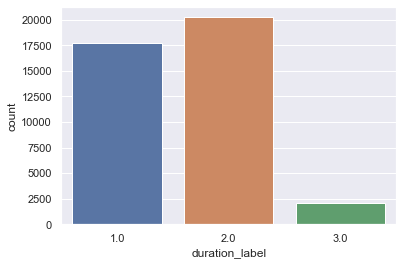

In [19]:
ax = sns.countplot(y, label="Count")
d1, d2, d3 = y.value_counts()
print("Duration 1.0", d1)
print("Duration 2.0", d2)
print("Duration 3.0", d3)

In [ ]:
data = pd.concat([y, exclude_non_numeric(X)], axis=1)
data = pd.melt(data, id_vars="duration_label", var_name="features", value_name="value")
plt.figure(figsize=(10, 10))
sns.boxplot(x="features", y="value", hue="duration_label", data=data)

In [ ]:
X_combined_50.corrwith(y).sort_values(key= lambda x: np.abs(x), ascending=False)[:20]

# Feature analysis (Pre-Processing)
## n_steps

Text(0.5, 1.0, 'Frequency histogram of n_steps')

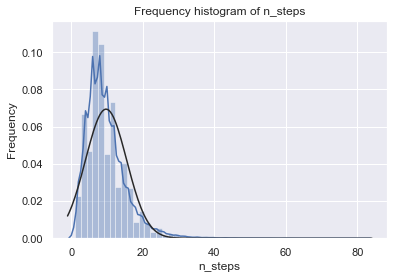

In [20]:
sns.distplot(X["n_steps"], fit=scipy.stats.norm)
plt.ylabel("Frequency")
plt.title("Frequency histogram of n_steps")

Text(0.5, 1.0, 'Probability Plot of n_steps')

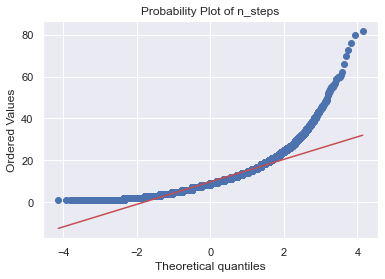

In [21]:
res = scipy.stats.probplot(X["n_steps"], plot=plt)
plt.title("Probability Plot of n_steps")

Text(0.5, 1.0, 'Frequency histogram of log(n_steps + 1)')

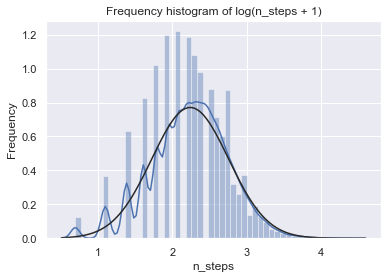

In [22]:
sns.distplot(np.log1p(X["n_steps"]), fit=scipy.stats.norm)
plt.ylabel("Frequency")
plt.title("Frequency histogram of log(n_steps + 1)")

Text(0.5, 1.0, 'Probability Plot of log(n_steps + 1)')

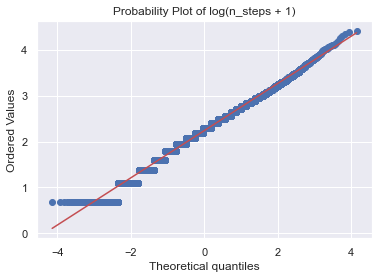

In [23]:
res = scipy.stats.probplot(np.log1p(X["n_steps"]), plot=plt)
plt.title("Probability Plot of log(n_steps + 1)")

In [29]:
temp_X = exclude_non_numeric(X)
temp_X = StandardScaler().fit_transform(np.log1p(temp_X))

Text(0.5, 1.0, 'Probability Plot of log(n_steps + 1) and StadardScaler')

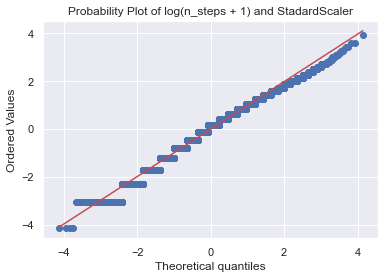

In [31]:
res = scipy.stats.probplot(temp_X[:, 0], plot=plt)
plt.title("Probability Plot of log(n_steps + 1) and StadardScaler")

## n_ingredients

In [ ]:
sns.distplot(X["n_ingredients"], fit=scipy.stats.norm)
plt.ylabel("Frequency")
plt.title("Frequency histogram of n_ingredients")

In [ ]:
res = scipy.stats.probplot(X["n_ingredients"], plot=plt)
plt.title("Probability Plot of n_ingredients")

In [ ]:
sns.distplot(np.log1p(X["n_ingredients"]), fit=scipy.stats.norm)
plt.ylabel("Frequency")
plt.title("Frequency histogram of log(n_ingredients + 1)")

In [ ]:
res = scipy.stats.probplot(np.log1p(X["n_ingredients"]), plot=plt)
plt.title("Probability Plot of log(n_ingredient + 1)")

## 50Vec2Doc

In [ ]:
scaled_train_name_vec50 = StandardScaler().fit_transform(train_name_vec50)



In [ ]:
sns.distplot(scaled_train_name_vec50[:, 0], fit=scipy.stats.norm)
plt.ylabel("Frequency")
plt.title("Frequency histogram of log(n_ingredients + 1)")

In [ ]:
res = scipy.stats.probplot(scaled_train_name_vec50[:, 0], plot=plt)
plt.title("Probability Plot of Doc2Vec feature 0")

In [ ]:
df = get_data("./COMP30027_2021_Project2_datasets/recipe_train.csv")

In [ ]:
sns.distplot(df[df["duration_label"]==3.0]["n_steps"])
print(df[df["duration_label"]==3.0]["n_steps"].mean())

In [ ]:
sns.distplot(df[df["duration_label"]==2.0]["n_steps"])
print(df[df["duration_label"]==2.0]["n_steps"].mean())

In [ ]:
sns.distplot(df[df["duration_label"]==1.0]["n_steps"])
print(df[df["duration_label"]==1.0]["n_steps"].mean())

## MLP analysis

In [2]:
partial_MLP_50Doc2Vec_model = pickle.load(open("partial_models/NN/partial_MLP_50Doc2Vec.sav", "rb"))

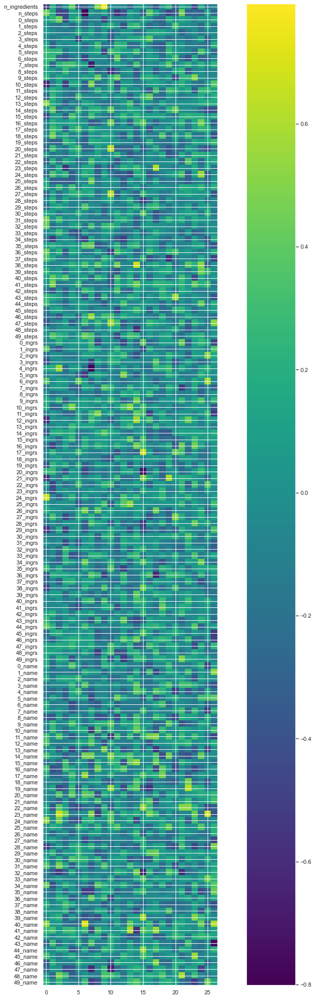

In [21]:
plt.figure(figsize=(20, 35))
plt.imshow(partial_MLP_50Doc2Vec_model['mlpclassifier'].coefs_[0], interpolation='none', cmap='viridis')
plt.yticks(range(152), X_combined_50.columns)
plt.colorbar()

In [29]:
train_name_countvec, train_ingr_countvec, train_steps_countvec = get_countvec()

/Users/mcken/.anyenv/envs/pyenv/versions/3.8.5/lib/python3.8/site-packages/sklearn/base.py:329: UserWarning: Trying to unpickle estimator CountVectorizer from version 0.21.3 when using version 0.23.2. This might lead to breaking code or invalid results. Use at your own risk.
  warnings.warn(


In [48]:
(len(train_name_countvec.vocabulary_), len(train_steps_countvec.vocabulary_), len(train_steps_countvec.vocabulary_))

(10892, 17967, 17967)

# words in the CountVectorizer

In [148]:
# sorted(train_ingr_countvec.vocabulary_)

In [150]:
len(sorted(train_steps_countvec.vocabulary_.keys()))
# sorted(train_name_countvec.vocabulary_.keys()))
# sorted(train_ingr_countvec.vocabulary_.keys()))

17967

## PCA

In [124]:
pca = PCA(n_components=3, svd_solver="arpack").fit(X_combined_50)
X_pca = pca.transform(X_combined_50)
PCA_data = np.vstack((X_pca.T, y)).T

Text(0.5, 0, 'component 3')

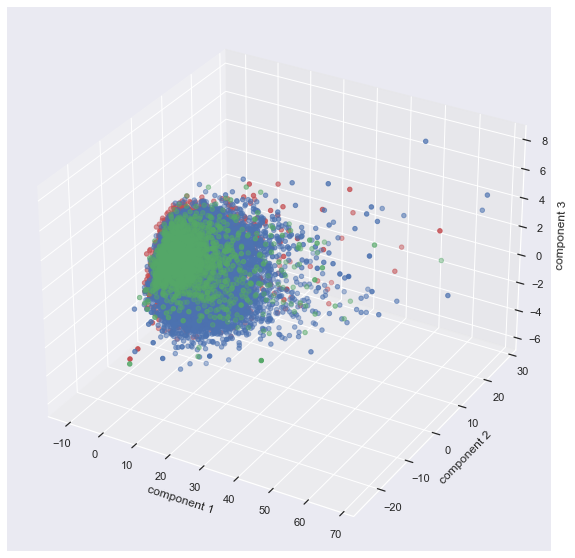

In [140]:
fig = plt.figure(figsize=(10, 10))
ax = plt.axes(projection='3d')
pca_dur_1 = PCA_data[PCA_data[:, 3] == 1.0]
pca_dur_2 = PCA_data[PCA_data[:, 3] == 2.0]
pca_dur_3 = PCA_data[PCA_data[:, 3] == 3.0]
ax.scatter(pca_dur_1[:, 0], pca_dur_1[:, 1], pca_dur_1[:, 2], c='r')
ax.scatter(pca_dur_2[:, 0], pca_dur_2[:, 1], pca_dur_2[:, 2], c='b')
ax.scatter(pca_dur_3[:, 0], pca_dur_3[:, 1], pca_dur_3[:, 2], c='g')
ax.set_xlabel("component 1")
ax.set_ylabel("component 2")

ax.set_zlabel("component 3")

In [136]:
pca_2 = PCA(n_components=2, svd_solver="arpack").fit(X_combined_50)
X_pca_2 = pca_2.transform(X_combined_50)
PCA_data_2 = np.vstack((X_pca_2.T, y)).T

Text(0, 0.5, 'component 2')

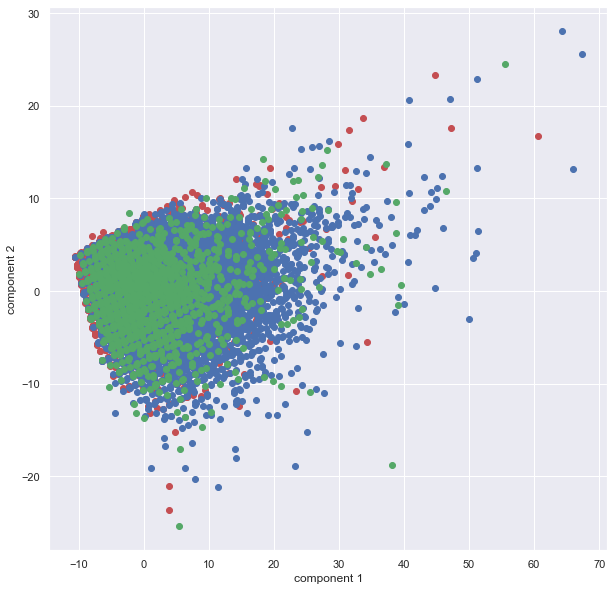

In [141]:
fig = plt.figure(figsize=(10, 10))
ax = plt.axes()
pca_2_dur_1 = PCA_data_2[PCA_data_2[:, 2] == 1.0]
pca_2_dur_2 = PCA_data_2[PCsA_data_2[:, 2] == 2.0]
pca_2_dur_3 = PCA_data_2[PCA_data_2[:, 2] == 3.0]
ax.scatter(pca_2_dur_1[:, 0], pca_2_dur_1[:, 1], c='r')
ax.scatter(pca_2_dur_2[:, 0], pca_2_dur_2[:, 1], c='b')
ax.scatter(pca_2_dur_3[:, 0], pca_2_dur_3[:, 1], c='g')
ax.set_xlabel("component 1")
ax.set_ylabel("component 2")